# longyearbyen_test

In [1]:
%load_ext autoreload
%autoreload 2
#import os
#import sys
#module_path = os.path.abspath(os.path.join('..'))
#if module_path not in sys.path:
#    sys.path.append(module_path)
#import oogeso
from oogeso.io import file_io
import oogeso.plots as plots
from oogeso.utils import create_time_series_data
import oogeso.dto
import matplotlib.pyplot as plt
import IPython.display
#import numpy as np
import pandas as pd
import logging
import pprint
import ipywidgets
import pickle
import plotly.express as px
import pyomo.environ as pyo
from dataclasses import asdict

logging.basicConfig()
logger = logging.getLogger()
logger.setLevel('INFO') #INFO
#print("Using Oogeso version {}".format(oogeso.__version__))

## Read input data

In [2]:
first = pd.read_csv('../tests/test_data/LYR_load.csv')
second = pd.read_csv('../tests/test_data/cap_factors_1hr_br_log.csv')
third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
assert isinstance(first, pd.DataFrame)

merged = pd.merge(first, second, how='left', on='timestamp')
merged = pd.merge(merged, third, how='left', on='timestamp')
merged = pd.merge(merged, fourth, how='left', on='timestamp')
merged.fillna(0,inplace=True)
#merged.to_csv('../tests/test_data/profiles_merged.csv', index=False)

In [3]:
#merged.set_index(merged["timestamp"], inplace=True)
merged

,timestamp,el_load,heat_load,V47,V105,local_time,PV,geothermal
0,2017-01-01 00:00:00,4.81,7.466778,0.456943,0.397433,2017-01-01 01:00:00,0.0,1.0
1,2017-01-01 01:00:00,4.33,7.551868,0.672022,0.633202,2017-01-01 02:00:00,0.0,1.0
2,2017-01-01 02:00:00,4.54,7.573140,0.633713,0.590261,2017-01-01 03:00:00,0.0,1.0
3,2017-01-01 03:00:00,4.69,7.573140,0.974162,1.000000,2017-01-01 04:00:00,0.0,1.0
4,2017-01-01 04:00:00,4.30,7.573140,0.804349,0.814672,2017-01-01 05:00:00,0.0,1.0
...,...,...,...,...,...,...,...,...
17515,2018-12-31 19:00:00,5.26,10.139872,0.029887,0.033634,2018-12-31 20:00:00,0.0,1.0
17516,2018-12-31 20:00:00,5.16,9.826704,0.019165,0.019081,2018-12-31 21:00:00,0.0,1.0
17517,2018-12-31 21:00:00,5.12,9.640496,0.000000,0.000166,2018-12-31 22:00:00,0.0,1.0
17518,2018-12-31 22:00:00,4.99,9.513536,0.035914,0.030137,2018-12-31 23:00:00,0.0,1.0


In [4]:
#case="_diesel_only"
#case="_diesel_battery"
#case="_ir_offshore_pv_geo"
#case="_ir_offshore_pv_geo_diesel"
#case="_br_onshore_pv_geo_diesel"
case="_br_onshore_pv_geo_diesel_2018"
timerange=[0,24*365] #one year (with 1 hour timestep)
#timerange=[0,24*7*50] #50 weeks (with 1 hour timestep)
timerange=[0,24*7] #one week (with 1 hour timestep)

outpath = "result/"
plots.plotter="plotly"

data = file_io.read_data_from_yaml("../tests/test_data/longyearbyen_test.yaml")
data.parameters.co2_tax = 2 # NOK/kgCO2 Political goal towards 2030

incl_battery=False
incl_geothermal=False
incl_resistiveheater=False
incl_wind=False
incl_pv=False
incl_hydrogen=False
incl_diesel=False

NOK_per_euro = 10

diesel_investment_cost = 0 # Already installed
diesel_fixed_op_cost = 8800/(3600*24*365) * NOK_per_euro # €/(MW*year) / 365*24*3600 s/year * NOK/€ => NOK/(MW)
diesel_op_cost = 6/3600 * NOK_per_euro # €/MWh / 3600 s/h * NOK/€ => NOK/MWs
diesel_fuel_cost = 7590

onshore_wind_investment_cost = 1.04*10**6 * NOK_per_euro # M€/MW * 10**6 * NOK/€ = NOK/MW
onshore_wind_fixed_op_cost = 12600/(3600*24*365) * NOK_per_euro # €/(MW*year) / 365*24*3600 s/year * NOK/€ => NOK/(MW)
onshore_wind_op_cost = 1.35/3600 * NOK_per_euro # €/MWh / 3600 s/h * NOK/€ => NOK/MWs

offshore_wind_investment_cost = 1.93*10**6 * NOK_per_euro # M€/MW * 10**6 * NOK/€ = NOK/MW
offshore_wind_fixed_op_cost = 36053/(3600*24*365) * NOK_per_euro # €/(MW*year) / 365*24*3600 s/year * NOK/€ => NOK/(MW)
offshore_wind_op_cost = 2.7/3600 * NOK_per_euro # €/MWh / 3600 s/h * NOK/€ => NOK/MWs

pv_investment_cost = 0.57*10**6 * NOK_per_euro # M€/MW * 10**6 * NOK/€ = NOK/MW
pv_fixed_op_cost = 8900/(3600*24*365) * NOK_per_euro # €/(MW*year) / 365*24*3600 s/year * NOK/€ => NOK/(MW)
pv_op_cost = 0/3600 * NOK_per_euro # €/MWh / 3600 s/h * NOK/€ => NOK/MWs

if case=="_diesel_only":
    # Combine profiles
    load = pd.read_csv('../tests/test_data/LYR_load.csv')
    load.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    incl_diesel=True
    for carrier in data.carriers:
        if carrier.id == "el":
            carrier.el_reserve_margin = 0

if case=="_diesel_battery":
    # Combine profiles
    load = pd.read_csv('../tests/test_data/LYR_load.csv')
    load.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    incl_battery=True
    incl_diesel=True
    for carrier in data.carriers:
        if carrier.id == "el":
            carrier.el_reserve_margin = 0

if case=="_ir_offshore_pv_geo":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir_log.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged = pd.merge(merged, fourth, how='left', on='timestamp')
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_profile="V105" # Offshore wind profile name with Isfjord Radio data
    pv_P_max=25 # MWp, Sun on all roofs
    pv_profile="PV" # Sun profile
    geothermal_P_max=1.3 # Wintertime power input
    geothermal_profile="geothermal"
    incl_battery=True
    incl_geothermal=True
    incl_resistiveheater=True
    incl_wind=True
    incl_pv=True
    incl_hydrogen=True
    wind_investment_cost = offshore_wind_investment_cost
    wind_fixed_op_cost = offshore_wind_fixed_op_cost
    wind_op_cost = offshore_wind_op_cost


elif case=="_ir_offshore_pv_geo_diesel":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir_log.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged = pd.merge(merged, fourth, how='left', on='timestamp')
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_profile="V105" # Offshore wind profile name with Isfjord Radio data
    pv_P_max=25 # MWp, Sun on all roofs
    pv_profile="PV" # Sun profile
    geothermal_P_max=1.3 # Wintertime input power
    geothermal_profile="geothermal"
    incl_battery=True
    incl_geothermal=True
    incl_resistiveheater=True
    incl_wind=True
    incl_pv=True
    incl_hydrogen=True
    incl_diesel=True
    wind_investment_cost = offshore_wind_investment_cost
    wind_fixed_op_cost = offshore_wind_fixed_op_cost
    wind_op_cost = offshore_wind_op_cost

elif case=="_br_onshore_pv_geo_diesel_2018":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_br_log.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged = pd.merge(merged, fourth, how='left', on='timestamp')
    merged.set_index(merged["timestamp"], inplace=True)
    merged = merged['2018-01-01':]
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    #timerange=[0,24*7*10] #one week (with 1 hour timestep)
    wind_P_max=3.45*10 # MW, 10 Vestas V105 turbines
    wind_profile="V105" # wind profile name with Breinosa data
    pv_P_max=25 # MWp, Sun on all roofs
    pv_profile="PV" # Sun profile
    geothermal_P_max=1.3 # Wintertime input power
    geothermal_profile="geothermal"
    incl_battery=True
    incl_geothermal=True
    incl_resistiveheater=True
    incl_wind=True
    incl_pv=True
    incl_hydrogen=True
    incl_diesel=True
    wind_investment_cost = onshore_wind_investment_cost
    wind_fixed_op_cost = onshore_wind_fixed_op_cost
    wind_op_cost = onshore_wind_op_cost

# Create profiles
timeseries = file_io.read_profiles_from_csv(
    filename_forecasts="../tests/test_data/profiles"+case+".csv",
    dayfirst = False)
profiles = create_time_series_data(
    df_forecast=timeseries["forecast"],
    df_nowcast=timeseries["forecast"],
    time_start=None,time_end=None,
    timestep_minutes=60,
    resample_method="linear")
data.profiles = profiles

winddevices = ["wind", "wind_farm", "el_wf_ps"]
pvdevices = ["pv", "el_pv_ps"]
batterydevices = ["el_storage"]
powersupplydevices = ["powersupply", "el_ps_load", "heat_ps_load"]
geothermaldevices = ["geothermal", "el_ps_geo", "heat_geo_load"]
resistiveheaterdevices = ["resistive_heater", "el_ps_rh", "heat_rh_load"]
hydrogendevices = ['electrolyser','fuelcell','h2_storage','el_ps_h2','heat_h2_load']
dieselgenerators = ['backup_east_1','backup_east_2','backup_east_3','backup_west_1','backup_west_2','backup_west_3']
dieselheaters = ['diesel_boiler_1','diesel_boiler_2','boiler_houses']
dieseldevices = dieselgenerators + dieselheaters + ['diesel_source', 'el_diesel_load', 'heat_diesel_load', 'diesel_backup']
diesel_source = "diesel_source"
for dev in data.devices:
    if dev.id in winddevices:
        dev.include = incl_wind
        if incl_wind:
            dev.flow_max = wind_P_max
            dev.flow_min = 0 #dev.flow_max
            dev.profile = wind_profile
            dev.investment_cost = wind_investment_cost
            dev.fixed_op_cost = wind_fixed_op_cost
            dev.op_cost = wind_op_cost
    if dev.id in pvdevices:
        dev.include = incl_pv
        if incl_pv:
            dev.flow_max = pv_P_max
            dev.flow_min = 0 #dev.flow_max
            dev.profile = pv_profile
            dev.investment_cost = pv_investment_cost
            dev.fixed_op_cost = pv_fixed_op_cost
            dev.op_cost = pv_op_cost
    if dev.id in batterydevices:
        dev.include = incl_battery
    if dev.id in hydrogendevices:
        dev.include = incl_hydrogen
    if dev.id in geothermaldevices:
        dev.include = incl_geothermal
        if incl_geothermal:
            dev.flow_max = geothermal_P_max
            dev.flow_min = 0
            dev.profile = geothermal_profile
    if dev.id in resistiveheaterdevices:
        dev.include = incl_resistiveheater
    if dev.id in dieseldevices:
        dev.include = incl_diesel
        if dev.id in dieselgenerators:
            dev.investment_cost = diesel_investment_cost
            dev.fixed_op_cost = diesel_fixed_op_cost
            dev.op_cost = diesel_op_cost
        if dev.id == diesel_source:
            dev.op_cost = diesel_fuel_cost
for edge in data.edges:
    if edge.id in winddevices:
        edge.include = incl_wind
    if edge.id in pvdevices:
        edge.include = incl_pv
    if edge.id in powersupplydevices:
        edge.include = incl_wind or incl_battery or incl_pv or incl_geothermal or incl_hydrogen or incl_resistiveheater
    if edge.id in geothermaldevices:
        edge.include = incl_geothermal
    if edge.id in resistiveheaterdevices:
        edge.include = incl_resistiveheater
    if edge.id in hydrogendevices:
        edge.include = incl_hydrogen
    if edge.id in dieseldevices:
        edge.include = incl_diesel
for node in data.nodes:
    if node.id in winddevices:
        node.include = incl_wind
    if node.id in pvdevices:
        node.include = incl_pv
    if node.id in powersupplydevices:
        node.include = incl_wind or incl_pv or incl_battery or incl_geothermal or incl_hydrogen or incl_resistiveheater
    if node.id in geothermaldevices:
        node.include = incl_geothermal
    if node.id in resistiveheaterdevices:
        node.include = incl_resistiveheater
    if node.id in hydrogendevices:
        node.include = incl_hydrogen
    if node.id in dieseldevices:
        node.include = incl_diesel

simulator = oogeso.Simulator(data)

In [5]:
data.devices[7]

DeviceStorageHydrogenCompressorData(id='h2_storage', node_id='h2_storage', name='compressed_h2_storage', include=True, profile=None, flow_min=None, flow_max=5.0, max_ramp_down=None, max_ramp_up=None, start_stop=None, compressor=CompressorData(eta=0.95, eta_heat=0.4, temperature=300.0, T_min=200, T_max=500, p_in=1.0, p_max=70.0, isothermal_adiabatic=0.5), reserve_factor=0, op_cost=None, op_cost_in=-0.05, op_cost_out=0.01, fixed_op_cost=None, investment_cost=0.0, penalty_function=None, model=<ModelType.STORAGE_HYDROGEN_COMPRESSOR: 'storagehydrogencompressor'>, electrolyser_id=None, E_max=3000000.0, E_min=100.0, eta=1.0, target_profile=None, E_cost=0, E_init=1500000.0)

In [6]:
for dev in data.devices:
    #if dev.id=='el_load':
    print(dev.id)

wind
pv
loadshed
el_load
heat_load
electrolyser
fuelcell
h2_storage
el_storage
geothermal
resistive_heater
heat_dump
el_dump
diesel_source
backup_east_1
backup_east_2
backup_east_3
backup_west_1
backup_west_2
backup_west_3
diesel_boiler_1
diesel_boiler_2
boiler_houses


In [7]:
# Test solve:
simulator.optimiser.solve(solver="gurobi")#, solver_options={"NonConvex":2})

{'Problem': [{'Name': 'x193943', 'Lower bound': -0.4200870095812218, 'Upper bound': -0.42008097302304637, 'Number of objectives': 1, 'Number of constraints': 54697, 'Number of variables': 40321, 'Number of binary variables': 10320, 'Number of integer variables': 10320, 'Number of continuous variables': 30001, 'Number of nonzeros': 110219, 'Sense': 'minimize'}], 'Solver': [{'Status': 'ok', 'Return code': '0', 'Message': 'Model was solved to optimality (subject to tolerances), and an optimal solution is available.', 'Termination condition': 'optimal', 'Termination message': 'Model was solved to optimality (subject to tolerances), and an optimal solution is available.', 'Wall time': '14.808084487915039', 'Error rc': 0, 'Time': 15.607237100601196}], 'Solution': [OrderedDict([('number of solutions', 0), ('number of solutions displayed', 0)])]}

In [8]:
#simulator.optimiser.constr_diesel_source_flowMin.pprint()

In [9]:
simulator.optimiser.paramDeviceEnergyInitially.pprint()

paramDeviceEnergyInitially : Size=22, Index=setDevice, Domain=NonNegativeReals, Default=None, Mutable=True
    Key              : Value
       backup_east_1 :         0
       backup_east_2 :         0
       backup_east_3 :         0
       backup_west_1 :         0
       backup_west_2 :         0
       backup_west_3 :         0
       boiler_houses :         0
     diesel_boiler_1 :         0
     diesel_boiler_2 :         0
       diesel_source :         0
             el_dump :         0
             el_load :         0
          el_storage :       3.0
        electrolyser :         0
            fuelcell :         0
          geothermal :         0
          h2_storage : 1500000.0
           heat_dump :         0
           heat_load :         0
                  pv :         0
    resistive_heater :         0
                wind :         0


In [10]:
simulator.optimiser.dual.pprint()

dual : Direction=Suffix.IMPORT, Datatype=Suffix.FLOAT
    Key : Value


In [11]:
simulator.optimiser.paramProfiles.pprint() # all 1 before update, from profile after
simulator.optimiser.paramDeviceIsOnInitially.pprint() # all 1 before and after update
simulator.optimiser.paramDevicePrepTimestepsInitially.pprint() # all 0 before and after update
simulator.optimiser.paramDevicePowerInitially.pprint() # unchanged before/after

paramProfiles : Size=1200, Index=paramProfiles_index, Domain=Reals, Default=None, Mutable=True
    Key                 : Value
              ('PV', 0) :     1
              ('PV', 1) :     1
              ('PV', 2) :     1
              ('PV', 3) :     1
              ('PV', 4) :     1
              ('PV', 5) :     1
              ('PV', 6) :     1
              ('PV', 7) :     1
              ('PV', 8) :     1
              ('PV', 9) :     1
             ('PV', 10) :     1
             ('PV', 11) :     1
             ('PV', 12) :     1
             ('PV', 13) :     1
             ('PV', 14) :     1
             ('PV', 15) :     1
             ('PV', 16) :     1
             ('PV', 17) :     1
             ('PV', 18) :     1
             ('PV', 19) :     1
             ('PV', 20) :     1
             ('PV', 21) :     1
             ('PV', 22) :     1
             ('PV', 23) :     1
             ('PV', 24) :     1
             ('PV', 25) :     1
             ('PV', 26) :     1
         

### Inspect input data

In [12]:
@ipywidgets.interact(datagroup=['','devices','nodes','edges','carriers','parameters'])
def showdata(datagroup):
    pprint.pprint(data.dict()[datagroup],indent=1) if datagroup!='' else print('')

interactive(children=(Dropdown(description='datagroup', options=('', 'devices', 'nodes', 'edges', 'carriers', …

In [13]:
yy=['']+list(simulator.optimiser.component_objects(oogeso.optimiser.pyo.Constraint, active=True))
@ipywidgets.interact(constraint=yy)
def showdata(constraint):
    pprint.pprint(constraint.pprint(),width=1) if constraint!='' else print('')

interactive(children=(Dropdown(description='constraint', options=('', <pyomo.core.base.constraint.IndexedConst…

In [14]:
for e in data.edges: print(e.id,e.bidirectional)

el_wf_ps True
el_pv_ps True
el_ps_load True
heat_h2_load True
el_ps_h2 True
el_ps_geo True
heat_geo_load True
el_ps_rh True
heat_rh_load True
el_diesel_load True
heat_diesel_load True


0 2016


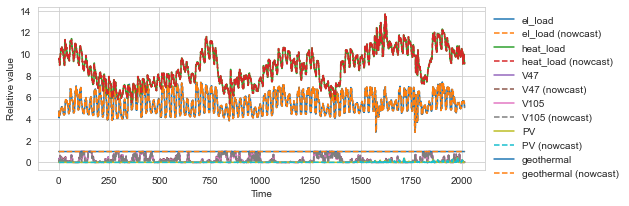

In [15]:
import matplotlib.dates as mdates
plt.figure(figsize=(8,3))
ax=plt.gca()
#day 6, hour 22: 6*24*12 + 22*12 = 
#tstart=7*24*12
#tlen=12*12
#xvalues = pd.date_range(start="00:00:00",freq="5min",periods=tlen)
#myFmt = mdates.DateFormatter('%H:%M')
#ax.xaxis.set_major_formatter(myFmt)
tstart=0
tlen=7*24*12
xvalues=range(tstart,tstart+tlen)
print(tstart,tlen)
for pr in profiles:
    if pr.id in ["curve_const","waterinj","h2target"]: continue
    color = next(ax._get_lines.prop_cycler)['color']
    plt.step(xvalues,pr.data[tstart:(tstart+tlen)],label=pr.id,color=color,where="post")
    if pr.data_nowcast is not None:
        color = next(ax._get_lines.prop_cycler)['color']
        plt.step(xvalues,pr.data_nowcast[tstart:(tstart+tlen)],"--",
                 label="{} (nowcast)".format(pr.id),color=color,where="post")        
plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
plt.xlabel("Time")
plt.ylabel("Relative value")
plt.savefig(outpath+"timerseries_ts{}_{}.pdf".format(tstart,case),dpi=300,bbox_inches="tight")

In [16]:
outpath

'result/'

In [17]:
# View profiles (entire available time windows)
scale=300/96 # ratio print vs screen dpi
fig=plots.plot_profiles(profiles,filename=None)
#fig.update_layout(template="plotly_white",autosize=False,width=600,height=200,margin=dict(l=0,r=0,t=0,b=0))
fig.show()
#300 dpi and 4 inch: 1200 pixels
#fig.write_image(outpath+"profiles.pdf",width=600,height=200,scale=scale)

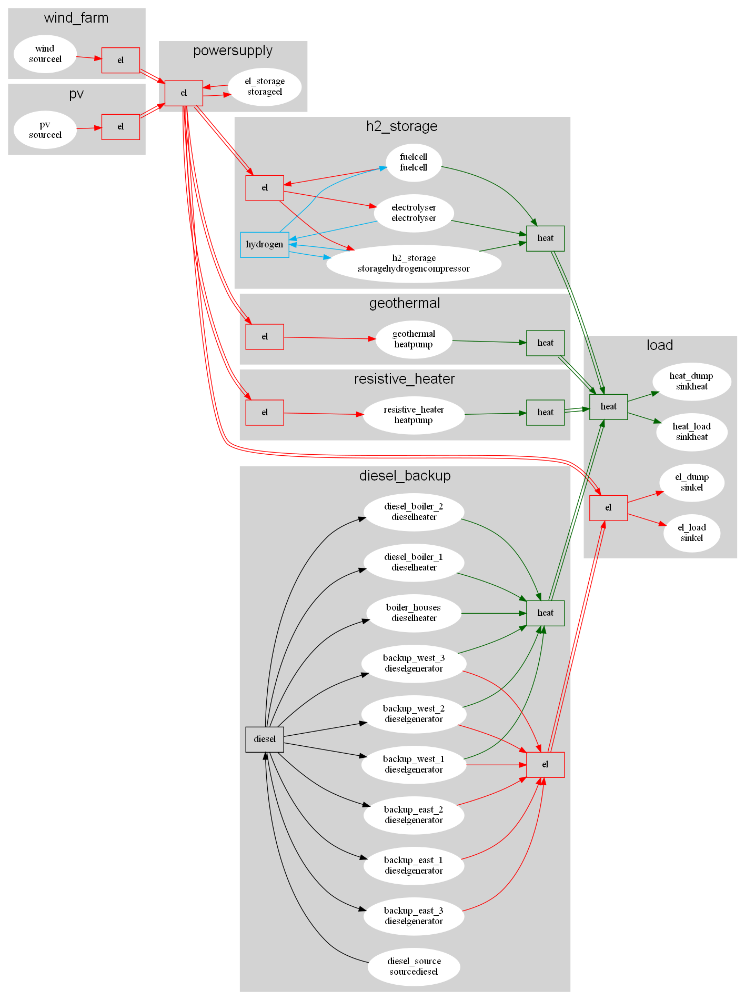

In [18]:
# View energy system
dotG=plots.plot_network(simulator,timestep=None,filename=None,rank_direction="LR",hide_edgelabel=True,only_carrier=None,fontsize=20,fontname = "helvetica",)
IPython.display.Image(dotG.create_png(prog="dot")) #scales automatically to page width
#dotG.write_pdf(path=outpath+"diagram0_{}.pdf".format(case))
# 

### Some checks on input data

In [19]:
if incl_geothermal:
    print(simulator.optimiser.all_edges['heat_geo_load'].edge_data)

id='heat_geo_load' node_from='geothermal' node_to='load' length_km=None flow_max=None investment_cost=None bidirectional=True include=True carrier=<CarrierType.HEAT: 'heat'> power_loss_function=None


## Solve

If the problem is infeasible, try 
* relaxing pressure deviation limits (generic value and per-node value)
* add a high cost emergency generator (that could represent load shedding) to ensure energy balance can be satisfied
* make sure excess heat/water/gas has a place to go


In [20]:
if incl_wind:
    dev_d=simulator.optimiser.all_devices["wind"].dev_data
if incl_wind or incl_pv or incl_battery or incl_geothermal or incl_hydrogen:
    node_d=simulator.optimiser.all_nodes["powersupply"].node_data

In [21]:
#simulator.optimiser.write("testplatform.mps")
#timerange=[0,24*7*6]
sim_result = simulator.run_simulation(solver="gurobi",time_range=timerange,write_yaml=False,time_limit=30)#, solver_options={"NonConvex":2})
print("Mean CO2 emission rate      = {:.1f} kgCO2/s".format(sim_result.co2_rate.mean()))
print("Mean CO2 emission intensity = {:.1f} kgCO2/Sm3oe".format(sim_result.co2_intensity.mean()))

100%|██████████| 355/355 [10:13:01<00:00, 103.61s/it]

Mean CO2 emission rate      = 0.2 kgCO2/s
Mean CO2 emission intensity = nan kgCO2/Sm3oe


In [22]:
#simulator.optimiser.updateOptimisationModel(timestep=0,profiles=data.profiles,first=True)
simulator.optimiser.write("test.mps",io_options = {"symbolic_solver_labels":True})

('test.mps', 3145192650064)

In [23]:
# Remove negligible dump values (Less than 1 W)
sim_result.device_flow["el_dump"]["el"]["in"][abs(sim_result.device_flow["el_dump"]["el"]["in"]) < 10**(-6)] = 0
sim_result.device_flow["heat_dump"]["heat"]["in"][abs(sim_result.device_flow["heat_dump"]["heat"]["in"]) < 10**(-6)] = 0
sim_result.op_cost_per_dev["el_dump"][sim_result.device_flow["el_dump"]["el"]["in"] == 0] = 0
sim_result.op_cost_per_dev["heat_dump"][sim_result.device_flow["heat_dump"]["el"]["in"] == 0] = 0

In [24]:
#simulator.optimiser.constrO_elReserveMargin[6].pprint()
#pyo.value(simulator.optimiser.varEdgeFlow["el_ps_load",10])

In [25]:
# print(pyo.value(simulator.optimiser.paramProfiles["V105",1]),
#     pyo.value(simulator.optimiser.varDeviceIsOn["wind",6]),
#     pyo.value(simulator.optimiser.varDeviceIsOn["electrolyser",6]),
#     pyo.value(simulator.optimiser.varDeviceIsOn["geothermal",6]),
# )

In [26]:
sim_result.op_cost_per_dev.backup_east_1

time
0       0.0
1       0.0
2       0.0
3       0.0
4       0.0
       ... 
8515    0.0
8516    0.0
8517    0.0
8518    0.0
8519    0.0
Length: 8520, dtype: object

## Save/Load simulation results
By saving to pickle file, it easy to later open and analyse the results without having to re-run the simulation

In [27]:
pickle_save='{}case{}.pkl'.format(outpath,case)
# Save (pickle) - for later opening and analysis
dumpdata={"data":data,"result":sim_result}
with open(pickle_save, mode='wb') as file:
   pickle.dump(dumpdata, file)
print("Results were saved to {}".format(pickle_save))

Results were saved to result/case_br_onshore_pv_geo_diesel_2018.pkl


In [28]:
# #Open previously saved object (including simulation results)
# pickle_save='{}case{}.pkl'.format(outpath,case)
# with open(pickle_save, mode='rb') as file:
#   sim_data = pickle.load(file)
# data=sim_data["data"]
# sim_result=sim_data["result"]
# simulator.result_object = sim_result

## Analyse results

In [29]:
import oogeso.result_analysis
kpi = oogeso.result_analysis.compute_kpis(sim_result, sim_data=data, fuel_carrier = "diesel", wind_turbines=['wind'], h2_storage=["h2_storage"])
kpi = pd.DataFrame.from_dict(kpi,orient="index",columns=[case])
kpi

,_br_onshore_pv_geo_diesel_2018
hours_simulated,8.520000e+03
kgCO2_per_year,4.834148e+06
kgCO2_per_Sm3oe,NaN
fuel_sm3_per_year,1.831117e+03
elconsumption_mwh_per_year,1.062340e+05
elconsumption_avg_mw,1.212717e+01
gt_starts_per_year,3.619155e+02
gt_stops_per_year,3.608873e+02
gt_hoursrunning_per_year,4.509549e+03
wind_output_mwh_per_year,6.751395e+04


In [30]:
sim_result.device_flow.wind.el.out.mean()

7.707072200899308

In [31]:
[c.energy_value for c in data.carriers if c.id == "hydrogen"][0]*3*10**6/3600

10666.666666666668

In [32]:
sim_result.device_flow.unstack("carrier")["hydrogen"].unstack("terminal")["in"].dropna().unstack().T[["h2_storage"]]

device,h2_storage
time,
0,0.000000
1,0.000000
2,0.000000
3,0.000000
4,0.000000
...,...
8515,1.360221
8516,0.949327
8517,0.433739


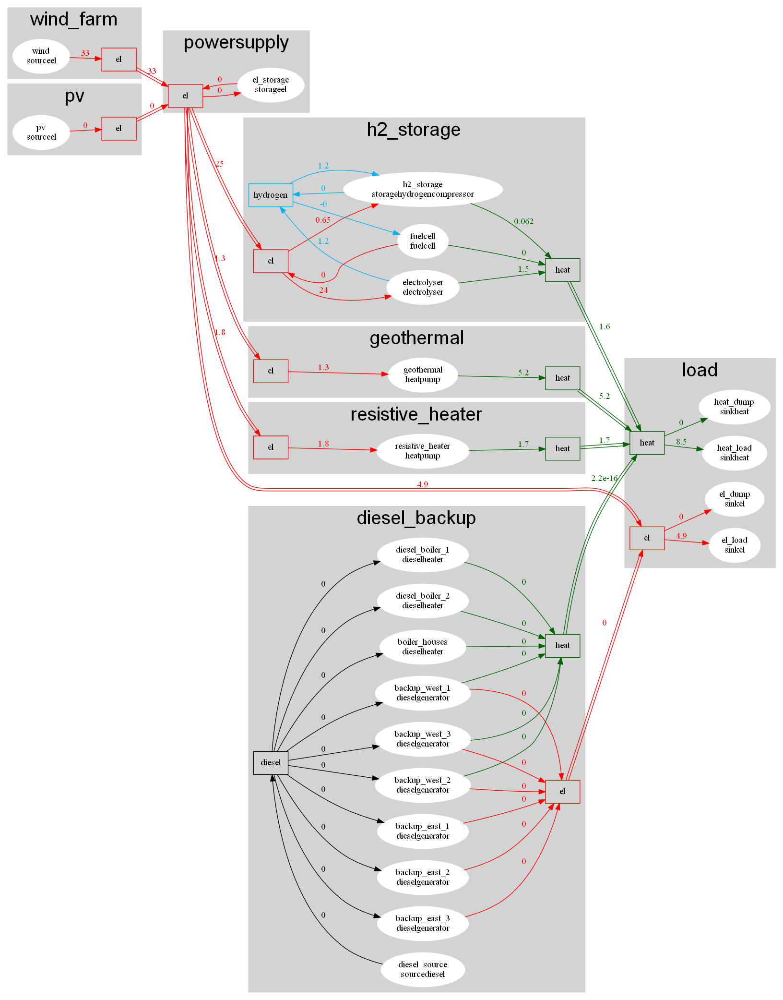

In [33]:
tstep=1272
gCombined = plots.plot_network(simulator=simulator,timestep=tstep,numberformat="{:.3g}",
                              filename=None,only_carrier=None,fontsize=30,fontname = "helvetica",
                              hide_losses=True)
IPython.display.Image(gCombined.create_png())
#gCombined.write_png(path=outpath+"diagram_{}.pdf".format(case),f="pdf")
#gCombined.write_pdf(path=outpath+"diagram_{}.pdf".format(case))

In [34]:
print(sim_result.device_flow.h2_storage.el["in"].to_string())

time
0       0.000000e+00
1       0.000000e+00
2       0.000000e+00
3       0.000000e+00
4       0.000000e+00
5       2.045792e-01
6       1.910352e-01
7       2.586886e-01
8       0.000000e+00
9       0.000000e+00
10      0.000000e+00
11      0.000000e+00
12      0.000000e+00
13      0.000000e+00
14      0.000000e+00
15      0.000000e+00
16      0.000000e+00
17      0.000000e+00
18      0.000000e+00
19      0.000000e+00
20      0.000000e+00
21      0.000000e+00
22      0.000000e+00
23      0.000000e+00
24      0.000000e+00
25      0.000000e+00
26      8.279688e-04
27      0.000000e+00
28      0.000000e+00
29      0.000000e+00
30      0.000000e+00
31      0.000000e+00
32      0.000000e+00
33      0.000000e+00
34      0.000000e+00
35      0.000000e+00
36      0.000000e+00
37      0.000000e+00
38      0.000000e+00
39      0.000000e+00
40      0.000000e+00
41      0.000000e+00
42      0.000000e+00
43      0.000000e+00
44      0.000000e+00
45      0.000000e+00
46      0.000000e+00
47      

In [35]:
for i in range(240):
    print(pyo.value(simulator.optimiser.varDeviceStorageEnergy["h2_storage",i]))

278482.5259561333
280842.35452643776
281530.06480829616
281571.0370582342
284113.28744585614
285101.77133649867
287103.09500252904
287966.3236582585
288025.868091807
288025.868091807
288025.868091807
288025.868091807
287888.3717397318
287338.20452159963
286828.6512047469
286900.5358253017
287493.42150160845
288902.32452321483
291773.0586390948
296669.8532898218
300087.43131359527
301648.8933419232
301648.8933419232
301648.8933419232
301648.8933419232
300010.7133419232
298205.8983419232
296424.8065920895
296424.8065920895
295633.4590920895
293878.0090920895
292051.1285185483
290021.9210185483
286692.6358919224
283232.3946907142
285612.72911660245
288777.0387494309
291474.744712229
290444.5116613815
289196.1639784839
290155.51107366773
293466.8841244703
291502.6841834942
291208.61009755667
289824.4831586245
287376.9331586245
284796.69903596106
281640.64114125574
278850.38764444937
276125.76707920834
273289.78295607044
270780.03853862017
268678.3737723918
265606.21908674086
262903.8440300

In [36]:
pyo.value(simulator.optimiser.paramDeviceEnergyInitially["h2_storage"])

276779.2343806033

In [37]:
sim_result.device_storage_energy.h2_storage

time
0       1.500000e+06
1       1.498242e+06
2       1.495397e+06
3       1.492226e+06
4       1.492226e+06
            ...     
8515    2.966699e+05
8516    3.000874e+05
8517    3.016489e+05
8518    3.016489e+05
8519    3.016489e+05
Length: 8520, dtype: float64

In [38]:
pyo.value(simulator.optimiser.varDeviceFlow["h2_storage","hydrogen","in",19])

1.3602207363130585

In [39]:
print(sim_result.device_flow.heat_dump.to_string())

carrier   terminal  time
diesel    in        0       0.0
                    1       0.0
                    2       0.0
                    3       0.0
                    4       0.0
                    5       0.0
                    6       0.0
                    7       0.0
                    8       0.0
                    9       0.0
                    10      0.0
                    11      0.0
                    12      0.0
                    13      0.0
                    14      0.0
                    15      0.0
                    16      0.0
                    17      0.0
                    18      0.0
                    19      0.0
                    20      0.0
                    21      0.0
                    22      0.0
                    23      0.0
                    24      0.0
                    25      0.0
                    26      0.0
                    27      0.0
                    28      0.0
                    29      0.0
               

In [40]:
#simulator.optimiser.all_nodes['wells'].devices_serial
#sim_result.dfEdgeFlow.unstack("edge").loc[151]
#simulator.optimiser.constrN_wells_energybalance["gas","out",0].pprint()
#print(pyo.value(simulator.optimiser.varDeviceFlow["wellL1","gas","out",0]))
#print(pyo.value(simulator.optimiser.varDeviceFlow["wellL2","gas","out",0]))
#print(pyo.value(simulator.optimiser.varEdgeFlow["cL2g",0]))
#print(pyo.value(simulator.optimiser.varEdgeLoss21["cL2g",0]))

In [41]:
combine = None
if incl_diesel: combine = [["diesel_generators"],[dieselgenerators]]

fig2=plots.plot_sum_power_mix(sim_result,simulator.optimiser,carrier="el",filename=None,devs_combine=combine,exclude_zero=True)#,devs_shareload=dieselgenerators, exclude_zero=True)#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix_{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutputel_{}x.pdf".format(case),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

In [42]:
combine = None
if incl_diesel: combine = [["diesel_boilers"],[dieselheaters]]

fig2=plots.plot_sum_power_mix(sim_result,simulator.optimiser,carrier="heat",filename=None,devs_combine=combine,exclude_zero=True)#,devs_shareload=dieselgenerators, exclude_zero=True)#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix_{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutputheat_{}x.pdf".format(case),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

In [43]:
plots.plotter="plotly"
gts = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["dieselgenerator","source_el"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=gts,filename=None,include_on_off=True, include_prep=False,devs_shareload=None)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white",
                 title="Power supply and on/off status (case: {})".format(case))
fig.show()

,el,heat
device,,
backup_east_1,0.000000,0.000000
backup_east_2,0.000000,0.000000
backup_east_3,0.000000,0.000000
backup_west_1,0.000000,0.000000
backup_west_2,0.000000,0.000000
backup_west_3,0.000000,0.000000
boiler_houses,0.000000,0.000000
diesel_boiler_1,0.000000,0.000000
diesel_boiler_2,0.000000,0.000000


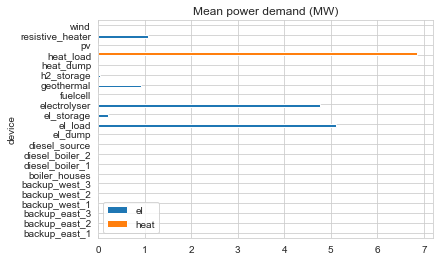

In [44]:
mean_el_demand = sim_result.device_flow.unstack('carrier')['el'].unstack('terminal')['in'].dropna().unstack().T.mean()
mean_heat_demand = sim_result.device_flow.unstack('carrier')['heat'].unstack('terminal')['in'].dropna().unstack().T.mean()
energydemand = pd.concat({'el':mean_el_demand,'heat':mean_heat_demand},axis=1)
#energydemand.drop('heatdump',inplace=True)
energydemand.plot.barh(title="Mean power demand (MW)")
energydemand

In [45]:
energydemand.sum()

el      12.127169
heat     6.855699
dtype: float64

In [46]:
mean_flows=sim_result.device_flow.unstack(["carrier","device","terminal"]).mean().unstack(["carrier","terminal"])
print("Mean flows:\n",mean_flows.sum())
print("Mean flow per device:")
mean_flows

Mean flows:
 carrier   terminal
diesel    in           0.000058
          out          0.000058
el        in          12.127169
          out         12.127169
heat      in           6.855699
          out          6.855699
hydrogen  in           0.515382
          out          0.515382
dtype: float64
Mean flow per device:


carrier                 diesel                  el                    heat  \
terminal                    in       out        in           out        in   
device                                                                       
backup_east_1     0.000000e+00  0.000000  0.000000  0.000000e+00  0.000000   
backup_east_2     5.410899e-24  0.000000  0.000000  7.818472e-20  0.000000   
backup_east_3     0.000000e+00  0.000000  0.000000  0.000000e+00  0.000000   
backup_west_1     1.656456e-05  0.000000  0.000000  2.247452e-01  0.000000   
backup_west_2     1.169519e-05  0.000000  0.000000  1.586690e-01  0.000000   
backup_west_3     1.678008e-05  0.000000  0.000000  2.278033e-01  0.000000   
boiler_houses     3.445641e-24  0.000000  0.000000  0.000000e+00  0.000000   
diesel_boiler_1   1.296750e-05  0.000000  0.000000  0.000000e+00  0.000000   
diesel_boiler_2   5.700033e-08  0.000000  0.000000  0.000000e+00  0.000000   
diesel_source     0.000000e+00  0.000058  0.000000  0.000000e+00  0.000000   
el_dump           0.000000e+00  0.000000  0.000000  0.000000e+00  0.000000   
el_load           0.000000e+00  0.000000  5.121251  0.000000e+00  0.000000   
el_storage        0.000000e+00  0.000000  0.214109  1.928821e-01  0.000000   
electrolyser      0.000000e+00  0.000000  4.764642  0.000000e+00  0.000000   
fuelcell          0.000000e+00  0.000000  0.000000  1.774733e+00  0.000000   
geothermal        0.000000e+00  0.000000  0.923401  0.000000e+00  0.000000   
h2_storage        0.000000e+00  0.000000  0.036292  0.000000e+00  0.000000   
heat_dump         0.000000e+00  0.000000  0.000000  0.000000e+00  0.000000   
heat_load         0.000000e+00  0.000000  0.000000  0.000000e+00  6.855699   
pv                0.000000e+00  0.000000  0.000000  1.841265e+00  0.000000   
resistive_heater  0.000000e+00  0.000000  1.067475  0.000000e+00  0.000000   
wind              0.000000e+00  0.000000  0.000000  7.707072e+00  0.000000   

carrier                         hydrogen            
terminal                   out        in       out  
device                                              
backup_east_1     0.000000e+00  0.000000  0.000000  
backup_east_2     0.000000e+00  0.000000  0.000000  
backup_east_3     0.000000e+00  0.000000  0.000000  
backup_west_1     2.527635e-01  0.000000  0.000000  
backup_west_2     1.784660e-01  0.000000  0.000000  
backup_west_3     2.559718e-01  0.000000  0.000000  
boiler_houses     1.075040e-19  0.000000  0.000000  
diesel_boiler_1   4.551594e-01  0.000000  0.000000  
diesel_boiler_2   2.000712e-03  0.000000  0.000000  
diesel_source     0.000000e+00  0.000000  0.000000  
el_dump           0.000000e+00  0.000000  0.000000  
el_load           0.000000e+00  0.000000  0.000000  
el_storage        0.000000e+00  0.000000  0.000000  
electrolyser      2.915961e-01  0.000000  0.238232  
fuelcell          7.098930e-01  0.277302  0.000000  
geothermal        3.693603e+00  0.000000  0.000000  
h2_storage        2.143929e-03  0.238080  0.277150  
heat_dump         0.000000e+00  0.000000  0.000000  
heat_load         0.000000e+00  0.000000  0.000000  
pv                0.000000e+00  0.000000  0.000000  
resistive_heater  1.014101e+00  0.000000  0.000000  
wind              0.000000e+00  0.000000  0.000000

In [47]:
plots.plotter="plotly"
gts = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["sourceel"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=gts,filename=None,include_on_off=False,include_prep=False,devs_shareload=None)
#fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.show()
#300 dpi and 4 inch: 1200 pixels
scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"powersupply.pdf",width=700,height=300,scale=scale)

In [48]:
df = sim_result.device_flow.unstack(["carrier", "terminal"])[("el", "out")].unstack("device")
df.index

Int64Index([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,
            ...
            8510, 8511, 8512, 8513, 8514, 8515, 8516, 8517, 8518, 8519],
           dtype='int64', name='time', length=8520)

In [49]:
import plotly
fig = plotly.subplots.make_subplots(rows=1, cols=1, shared_xaxes=True)
if incl_wind:
    fig.add_scatter(
                    x=df.index,
                    y=df["wind"],
                    line_shape="hv",
                    name="wind",
                    #line=dict(color=colour[k]),
                    stackgroup="P",
                    legendgroup="wind",
                    row=1,
                    col=1,
                )

In [50]:
dfStartopt = pd.DataFrame()
inst=simulator.optimiser
for t in inst.setHorizon: 
    if incl_wind: dfStartopt.loc[t,'start']=inst.varDeviceStarting['wind',t].value
    if incl_geothermal: dfStartopt.loc[t,'prep']=inst.varDeviceIsPrep['geothermal',t].value
    if incl_hydrogen: 
        dfStartopt.loc[t,'on']=inst.varDeviceIsOn['electrolyser',t].value
        dfStartopt.loc[t,'stop']=inst.varDeviceStopping['fuelcell',t].value
dfStartopt.head()

,start,prep,on,stop
0,NaN,0.0,1.0,NaN
1,NaN,0.0,1.0,NaN
2,NaN,0.0,1.0,NaN
3,NaN,0.0,1.0,NaN
4,NaN,0.0,1.0,NaN


In [51]:
if incl_wind:
    fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=['wind'],filename=None,include_forecasts=True)
    fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=0,b=0))

In [52]:
"""
df=sim_result.device_flow.unstack([0,1,2])[[('ex_g','gas','in'),('ex_o','oil','in')]]
df.columns=['gas','oil']
df=df.reset_index()
df["gas"]=df["gas"]/1000 # convert to oil equivalents
df = df.melt(var_name="Product",value_name="Volume rate (Sm3oe/s)",id_vars=('time'))
px.line(df,x="time",y="Volume rate (Sm3oe/s)",color="Product",title="Oil/gas export volumes (Sm3oe/s)").show()

plots.plot_export_revenue(sim_result)
"""

'\ndf=sim_result.device_flow.unstack([0,1,2])[[(\'ex_g\',\'gas\',\'in\'),(\'ex_o\',\'oil\',\'in\')]]\ndf.columns=[\'gas\',\'oil\']\ndf=df.reset_index()\ndf["gas"]=df["gas"]/1000 # convert to oil equivalents\ndf = df.melt(var_name="Product",value_name="Volume rate (Sm3oe/s)",id_vars=(\'time\'))\npx.line(df,x="time",y="Volume rate (Sm3oe/s)",color="Product",title="Oil/gas export volumes (Sm3oe/s)").show()\n\nplots.plot_export_revenue(sim_result)\n'

In [53]:
simulator.optimiser.setDevice.pprint()

setDevice : device
    Size=1, Index=None, Ordered=Insertion
    Key  : Dimen : Domain : Size : Members
    None :     1 :    Any :   22 : {'wind', 'pv', 'el_load', 'heat_load', 'electrolyser', 'fuelcell', 'h2_storage', 'el_storage', 'geothermal', 'resistive_heater', 'heat_dump', 'el_dump', 'diesel_source', 'backup_east_1', 'backup_east_2', 'backup_east_3', 'backup_west_1', 'backup_west_2', 'backup_west_3', 'diesel_boiler_1', 'diesel_boiler_2', 'boiler_houses'}


In [54]:
plots.plotter="plotly"
if 'el_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'el_storage',
                                 filename=None)#outpath+"battery_opt.png")
    fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
#    oogeso.plots.optimization_plots.plot_device_power_last_optimisation_1(mc,device='battery', filename=None)#outpath+"lastopt_battery.png")

In [55]:
plots.plotter="plotly"
if 'h2_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'h2_storage',
                                 filename=None)#outpath+"battery_opt.png")
    #fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
    fig.show()

In [56]:
sim_result.device_flow["h2_storage", "el"].unstack("terminal")[0:10]

terminal,in,out
time,,
0,0.000000,0.0
1,0.000000,0.0
2,0.000000,0.0
3,0.000000,0.0
4,0.000000,0.0
5,0.204579,0.0
6,0.191035,0.0
7,0.258689,0.0
8,0.000000,0.0


In [57]:
sim_result.device_storage_energy.h2_storage

time
0       1.500000e+06
1       1.498242e+06
2       1.495397e+06
3       1.492226e+06
4       1.492226e+06
            ...     
8515    2.966699e+05
8516    3.000874e+05
8517    3.016489e+05
8518    3.016489e+05
8519    3.016489e+05
Length: 8520, dtype: float64

In [58]:
if incl_hydrogen: simulator.optimiser.all_devices["h2_storage"].dev_data.model

In [59]:
plots.plotter="plotly"
fig=plots.plot_CO2_rate_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt.png")#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [60]:
plots.plotter="plotly"
combine = None
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselheaters]]

fig=plots.plot_CO2_rate_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",device_combine=combine)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [61]:
fig = plots.plot_CO2_rate(sim_result)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [62]:
fig=plots.plot_CO2_intensity(sim_result,filename=outpath+"co2intensity_opt.png")
fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=0,b=0))

In [63]:
fig = plots.plot_op_cost(sim_result)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [64]:
plots.plotter="plotly"
combine = None

fig=plots.plot_op_cost_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",device_combine=combine)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [65]:
plots.plotter="plotly"
combine = None
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselheaters]]

fig=plots.plot_op_cost_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",device_combine=combine)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [66]:
fig = plots.plot_all_costs(sim_result, simulator.optimiser)
fig.show()

In [67]:
fig = plots.plot_all_costs_per_device(sim_result, simulator.optimiser, include_sum=True)
fig.show()

13517402.995394606


In [68]:
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselheaters]]
fig = plots.plot_all_costs_per_device(sim_result, simulator.optimiser, include_sum=True, device_combine=combine)
fig.show()

13517402.995394606


In [69]:
plots.plotter="plotly"
fig=plots.plot_reserve(sim_result,simulator.optimiser,dynamic_margin=True,include_sum=False)
#plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
#fig.set_size_inches(5.92,1.5)
#plt.savefig("result/reserve_{}x.pdf".format(case),dpi=300,bbox_inches="tight")
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [70]:
plots.plotter="plotly"
combine = [["diesel_generators"],[dieselgenerators]]

fig=plots.plot_reserve(sim_result,simulator.optimiser,dynamic_margin=True,include_sum=False,device_combine=combine)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [71]:
# This plot shows per device its output (dotted line) and the available online backup, iel reserve 
# by _other_ devices (solid line). MARGIN(t) = min_devices(backup(t) - output(t))
plots.plot_el_backup(sim_result,show_margin=True,return_margin=False)

In [72]:
if incl_hydrogen:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,"h2_storage")
    fig.update_layout(autosize=False,width=800,height=250,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
    fig.update_yaxes(tick0=0, dtick=1,secondary_y=True,range=[0,5.5])
    fig.update_yaxes(tick0=0, dtick=100e3,secondary_y=False,range=[0,550e3])
    fig.show()
    fig.write_image(outpath+"h2_storage_{}.pdf".format(case))

In [73]:
simulator.optimiser.all_devices

{'wind': <oogeso.core.devices.source.SourceEl at 0x2dc43885f30>,
 'pv': <oogeso.core.devices.source.SourceEl at 0x2dc43885ea0>,
 'el_load': <oogeso.core.devices.sink.SinkEl at 0x2dc43885a20>,
 'heat_load': <oogeso.core.devices.sink.SinkHeat at 0x2dc438856c0>,
 'electrolyser': <oogeso.core.devices.electrolyser.Electrolyser at 0x2dc43885600>,
 'fuelcell': <oogeso.core.devices.fuelcell.FuelCell at 0x2dc43884280>,
 'h2_storage': <oogeso.core.devices.storage.StorageHydrogenCompressor at 0x2dc438843d0>,
 'el_storage': <oogeso.core.devices.storage.StorageEl at 0x2dc43884130>,
 'geothermal': <oogeso.core.devices.heatpump.HeatPump at 0x2dc43885ba0>,
 'resistive_heater': <oogeso.core.devices.heatpump.HeatPump at 0x2dc43884460>,
 'heat_dump': <oogeso.core.devices.sink.SinkHeat at 0x2dc43885ab0>,
 'el_dump': <oogeso.core.devices.sink.SinkEl at 0x2dc43885750>,
 'diesel_source': <oogeso.core.devices.source.SourceDiesel at 0x2dc438842b0>,
 'backup_east_1': <oogeso.core.devices.dieselgenerator.DieselG

In [74]:
sim_result.el_backup.unstack("device")

device,backup_east_1,backup_east_2,backup_east_3,backup_west_1,backup_west_2,backup_west_3,el_storage,fuelcell,pv,wind
time,,,,,,,,,,
0,45.000000,45.000000,45.000000,45.000000,45.000000,45.000000,45.000000,0.000000e+00,45.000000,45.000000
1,41.874353,41.874353,41.874353,41.874353,41.874353,41.874353,41.874353,0.000000e+00,41.874353,41.874353
2,39.942970,39.942970,39.942970,39.942970,39.942970,39.942970,39.942970,0.000000e+00,39.942970,39.942970
3,39.363121,39.363121,39.363121,39.363121,39.363121,39.363121,39.363121,0.000000e+00,39.363121,39.363121
4,45.000000,45.000000,45.000000,45.000000,45.000000,45.000000,45.000000,0.000000e+00,45.000000,45.000000
...,...,...,...,...,...,...,...,...,...,...
8515,72.204415,72.204415,72.204415,72.204415,72.204415,72.204415,72.204415,2.720441e+01,72.204415,72.204415
8516,63.986545,63.986545,63.986545,63.986545,63.986545,63.986545,63.986545,1.898654e+01,63.986545,63.986545
8517,53.674789,53.674789,53.674789,53.674789,53.674789,53.674789,53.674789,8.674789e+00,53.674789,53.674789


In [75]:
simulator.profiles["nowcast"]

,el_load,heat_load,V47,V105,PV,geothermal
0,4.73,9.488144,0.326000,0.249744,0.0,1.0
1,4.12,9.581248,0.221897,0.162033,0.0,1.0
2,4.46,9.522000,0.120876,0.090527,0.0,1.0
3,4.38,9.225760,0.069881,0.055285,0.0,1.0
4,4.43,8.963376,0.451660,0.381192,0.0,1.0
...,...,...,...,...,...,...
8755,5.26,10.139872,0.029887,0.033634,0.0,1.0
8756,5.16,9.826704,0.019165,0.019081,0.0,1.0
8757,5.12,9.640496,0.000000,0.000166,0.0,1.0
8758,4.99,9.513536,0.035914,0.030137,0.0,1.0


In [76]:
fig = plots.plot_unused_profile_power(simulator)
fig.show()